In [11]:
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import linregress
import seaborn as sns
import time
import numpy as np

print("All Imports are sucessfull")

All Imports are sucessfull


In [3]:
file = 'employee_data.csv'
try:
    if file is not None:
        dataframe = pd.read_csv(file)
        print("File opened sucessfully")
    
except FileExistsError as e:
    print(f"Error: {e}")

dataframe

File opened sucessfully


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8


In [4]:
dataframe.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

First, we need to plot each column value against eachother. This will make sure we capture all linear relationships in the dataframe

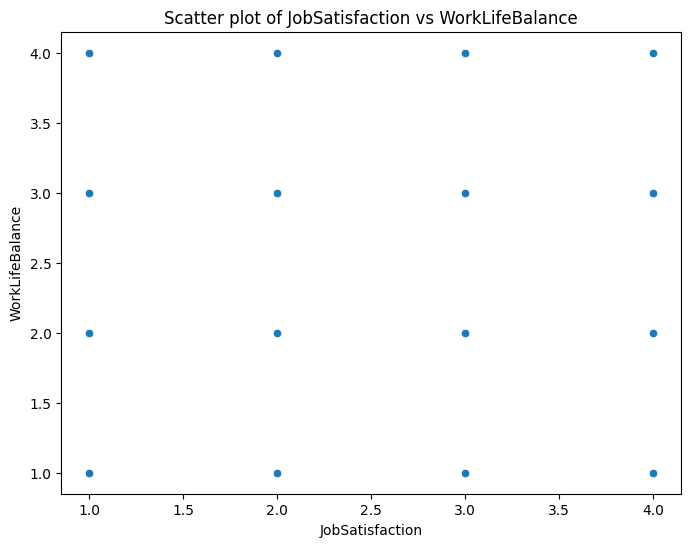

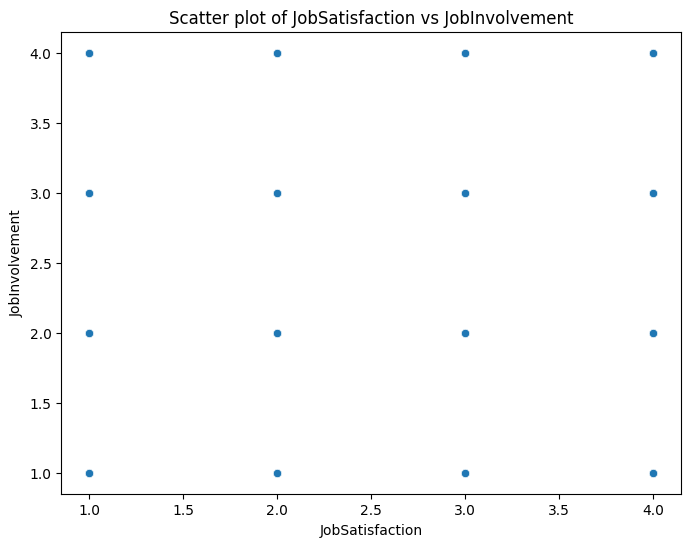

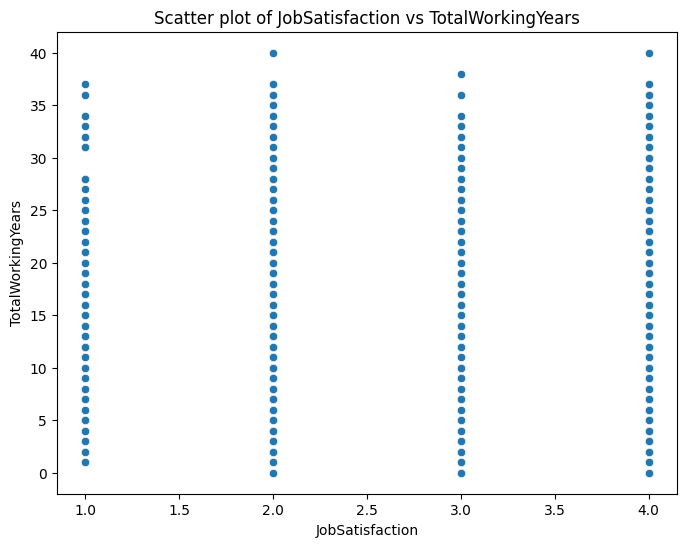

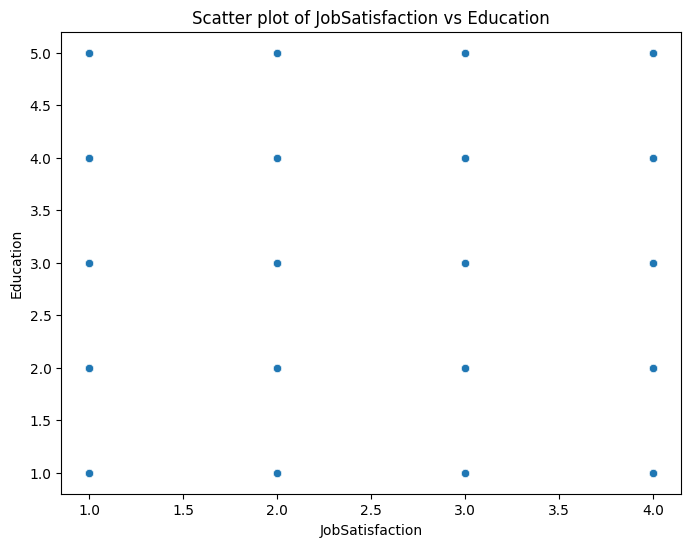

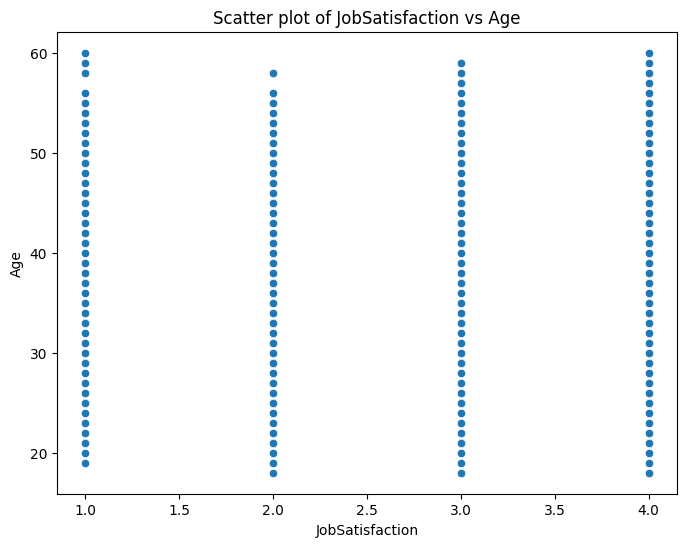

...

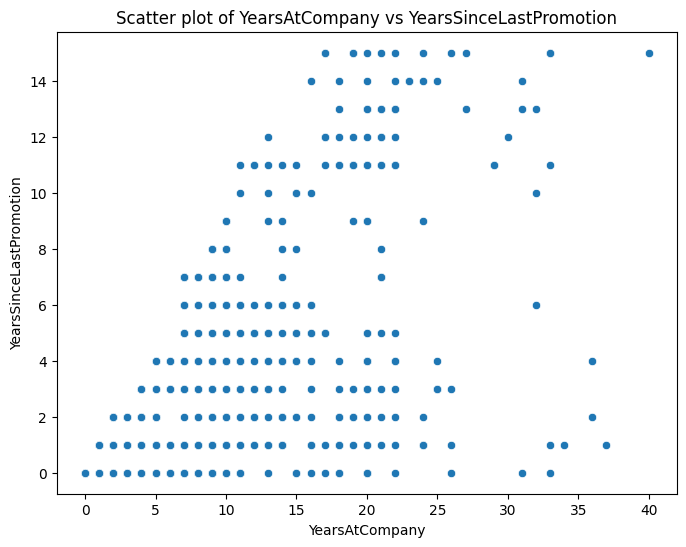

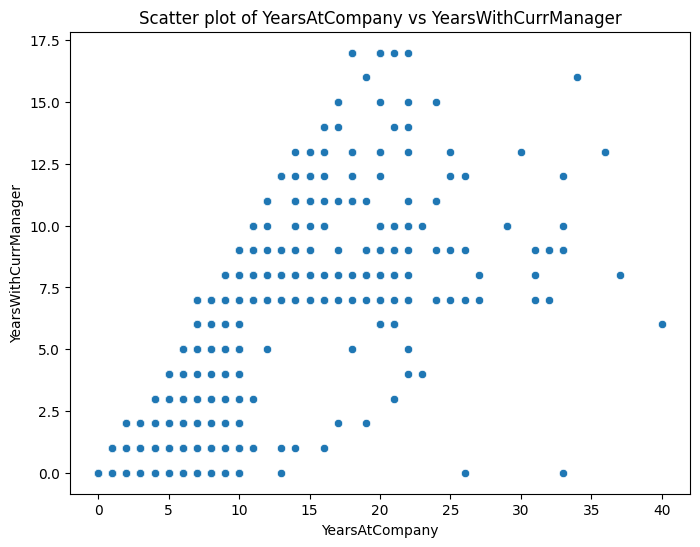

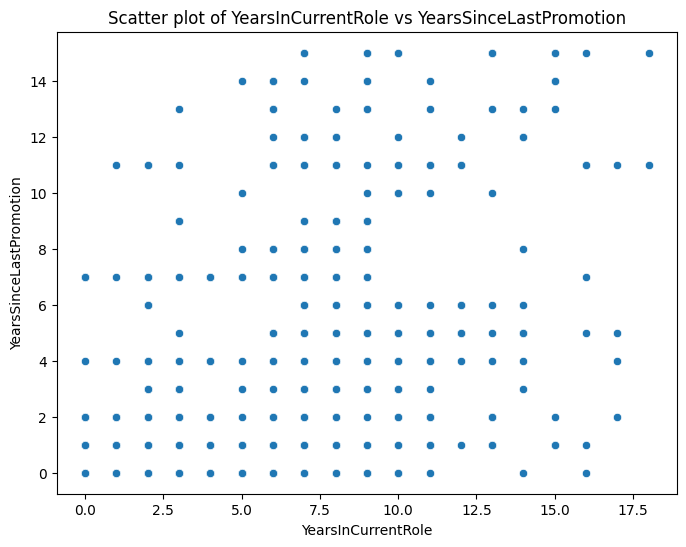

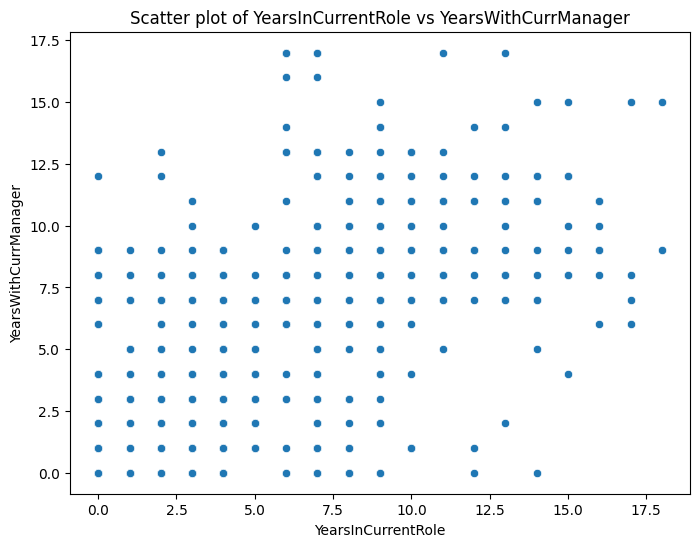

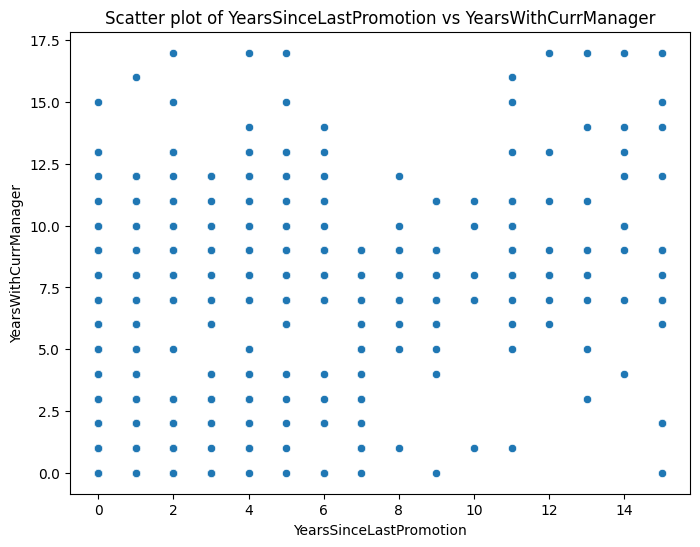

In [11]:
# Scripting that plots all the values against eachother.
relevant_columns = [
    'JobSatisfaction', 'WorkLifeBalance', 'JobInvolvement', 'TotalWorkingYears', 'Education',
    'Age', 'BusinessTravel', 'DailyRate', 'Department', 'DistanceFromHome', 'EducationField',
    'EmployeeCount', 'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
    'JobLevel', 'JobRole', 'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
    'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
    'StandardHours', 'StockOptionLevel', 'TrainingTimesLastYear', 'YearsAtCompany',
    'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager'
]

# Loop through relevant columns and create pair plots
for i in range(len(relevant_columns)):
    for j in range(i + 1, len(relevant_columns)):
        plt.figure(figsize=(8, 6))
        sns.scatterplot(x=dataframe[relevant_columns[i]], y=dataframe[relevant_columns[j]])
        plt.xlabel(relevant_columns[i])
        plt.ylabel(relevant_columns[j])
        plt.title(f'Scatter plot of {relevant_columns[i]} vs {relevant_columns[j]}')
        plt.show()


From these, it is evident that the number of years an employee stays in a company determines the value that they are more likely t bring. All the linear relationships that were depiced had the number of years as an independent variable. The plots were directional and proportional. 

In [5]:
collected_array = [
    'YearsWithCurrManager',
    'TotalWorkingYears',
    'YearsInCurrentRole',
    'DailyRate',
    'DistanceFromHome',
    'MonthlyIncome',
    'YearsAtCompany',
    'YearsSinceLastPromotion',
    'Age',
    'HourlyRate',
]

Please select an option below:
0: YearsWithCurrManager
1: TotalWorkingYears
2: YearsInCurrentRole
3: DailyRate
4: DistanceFromHome
5: MonthlyIncome
6: YearsAtCompany
7: YearsSinceLastPromotion
8: Age
9: HourlyRate

Slope: 0.4945870139139735
Intercept: 1.4294236206070785
Standard Error of Coefficients: 0.015990669720404322
Correlation coefficient: 0.6281331552682461
p-Value: 3.671093916703559e-162

A p-value close to 0.05 indicates evidence to potentially reject the null hypothesis.
An r-value close to 1 (or -1) indicates a strong linear relationship between the variables.

Moderate positive linear relationship
Strong evidence against the null hypothesis (significant relationship)


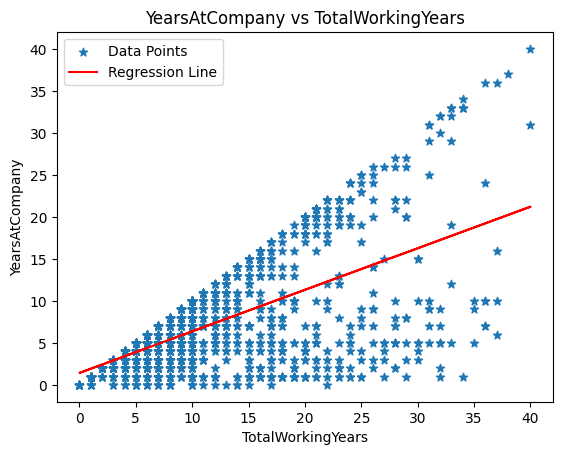

In [10]:

# Display the options with indices
print("Please select an option below:")

for idx, option in enumerate(collected_array):
    print(f"{idx}: {option}")

# Pause for user to read the options
time.sleep(3)

# Get user input
index_of_independent_array = int(input('Independent Option: '))
index_of_dependent_array = int(input('Dependent Option: '))

# Retrieve column names based on indices
independent_column = collected_array[index_of_independent_array]
dependent_column = collected_array[index_of_dependent_array]

# Perform linear regression
slope, intercept, r, p, std_err = linregress(dataframe[independent_column], dataframe[dependent_column])

# Define linear equation function
def linear_equation(x):
    return slope * x + intercept

# Print regression results

print(f"\nSlope: {slope}")
print(f"Intercept: {intercept}")
print(f"Standard Error of Coefficients: {std_err}")
print(f"Correlation coefficient: {r}")
print(f"p-Value: {p}")

print("\nA p-value close to 0.05 indicates evidence to potentially reject the null hypothesis.\nAn r-value close to 1 (or -1) indicates a strong linear relationship between the variables.\n")

# insight on coorelation coefficient and p-value...
if r == 1:
    print('Perfect positive linear relationship')
    
elif 0.7 <= r < 1:
    print('Strong positive linear relationship')
elif 0.3 <= r < 0.7:
    print('Moderate positive linear relationship')
elif 0.1 <= r < 0.3:
    print('Weak positive linear relationship')

elif r == 0:
    print('No linear relationship: y = c')

elif -0.3 < r <= -0.1:
    print('Weak negative linear relationship')
elif -0.7 < r <= -0.3:
    print('Moderate negative linear relationship')
elif -1 < r <= -0.7:
    print('Strong negative linear relationship')

elif r == -1:
    print('Perfect negative linear relationship')

else:
    print(f'{r} does not indicate a linear relationship')

time.sleep(1)

if p <= 0.05:
    print('Strong evidence against the null hypothesis (significant relationship)')
elif 0.05 < p <= 0.1:
    print('Moderate evidence against the null hypothesis (marginally significant relationship)')
else:
    print('Weak evidence against the null hypothesis (no significant relationship)')


# Calculate predicted values
y_hat_values = list(map(linear_equation, dataframe[independent_column]))

# Plot the results
plt.scatter(dataframe[independent_column], dataframe[dependent_column], label='Data Points', marker='*')
plt.plot(dataframe[independent_column], y_hat_values, color='red', label='Regression Line')

# Set plot labels and title
plt.xlabel(independent_column)
plt.ylabel(dependent_column)
plt.title(f"{dependent_column} vs {independent_column}")

# Show legend and plot
plt.legend()
plt.show()

In [7]:
print("List of options: ")
for index, option in enumerate(collected_array):
    print(f"{index}: {option}")


predictive_value = int(input('State of x: '))

index_of_independent_for_prediction = int(input('Which independent array would you like to use: ')) 
index_of_dependent_for_prediction = int(input('Which dependent array would you like to use: '))

I_column = collected_array[index_of_independent_for_prediction]
D_column = collected_array[index_of_dependent_for_prediction]

predict_slope, predict_intercept, predict_r, predict_p, predict_std_err = linregress(dataframe[I_column], dataframe[D_column])

prediction_value = predict_slope * predictive_value + predict_intercept

print(f"\nThe state of y when x is {predictive_value} is:", prediction_value)

List of options: 
0: YearsWithCurrManager
1: TotalWorkingYears
2: YearsInCurrentRole
3: DailyRate
4: DistanceFromHome
5: MonthlyIncome
6: YearsAtCompany
7: YearsSinceLastPromotion
8: Age
9: HourlyRate


ValueError: invalid literal for int() with base 10: ''

List of options: 
0: YearsWithCurrManager
1: TotalWorkingYears
2: YearsInCurrentRole
3: DailyRate
4: DistanceFromHome
5: MonthlyIncome
6: YearsAtCompany
7: YearsSinceLastPromotion
8: Age
9: HourlyRate


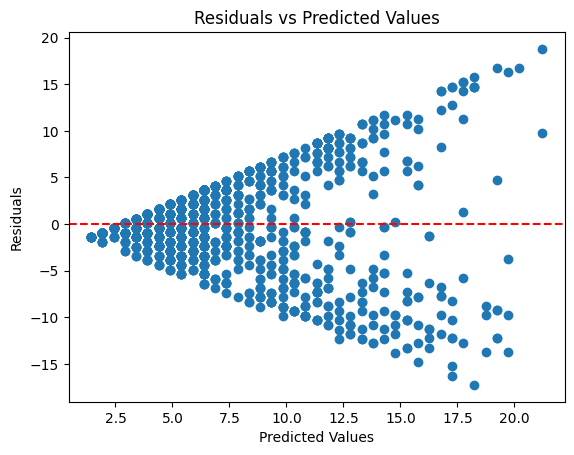

Correlation coefficient is moderate and positive.
The p-value: 3.671093916703559e-162
The slope: 0.4945870139139735. The initial slope was: 0.49458
Y-Hut Values: [5.386119731918866, 6.375293759746813, 4.891532718004893, 5.386119731918866, 4.3969457040909194, 5.386119731918866, 7.36446778757476, 1.924010634521052, 6.375293759746813, 9.837402857144628, 4.3969457040909194, 6.375293759746813, 3.902358690176946, 2.913184662348999, 4.3969457040909194, 6.375293759746813, 4.891532718004893, 1.924010634521052, 16.761621051940256, 4.3969457040909194, 3.902358690176946, 6.375293759746813, 7.859054801488734, 1.4294236206070785, 5.386119731918866, 14.288685982370389, 6.375293759746813, 6.375293759746813, 13.299511954542442, 12.310337926714494, 4.891532718004893, 5.88070674583284, 6.375293759746813, 10.826576884972575, 4.3969457040909194, 4.3969457040909194, 2.913184662348999, 2.4185976484350253, 4.3969457040909194, 6.375293759746813, 1.924010634521052, 1.924010634521052, 1.924010634521052, 5.880706

In [13]:
# Test
def mean_square_error(dependent_values, y_hut):
    return np.mean((dependent_values - y_hut) ** 2)

print("List of options: ")
for index, option in enumerate(collected_array):
    print(f"{index}: {option}")

independent_state = int(input('State of x: '))
index_of_independent_for_prediction = int(input('Which independent array would you like to use: ')) 
index_of_dependent_for_prediction = int(input('Which dependent array would you like to use: '))

Ind_column = collected_array[index_of_independent_for_prediction]
Dep_column = collected_array[index_of_dependent_for_prediction]

test_slope, test_intercept, test_r, test_p, test_std_err = linregress(dataframe[Ind_column], dataframe[Dep_column])

test_response = test_slope * independent_state + test_intercept

def linear_eq(independent_value):
    return test_slope * independent_value + test_intercept

y_hut_test = list(map(linear_eq, dataframe[Ind_column]))

# Correct calculation of residuals
residuals = dataframe[Dep_column] - y_hut_test

# Plot residuals against predicted values
plt.scatter(y_hut_test, residuals)
plt.title("Residuals vs Predicted Values")
plt.xlabel("Predicted Values")
plt.ylabel("Residuals")
plt.axhline(0, color='red', linestyle='--')
plt.show()

mean_square_value = mean_square_error(dataframe[Dep_column], y_hut_test)

# Print r and p-values with appropriate messages
if test_r == 1:
    print("The correlation coefficient is perfectly positive.")
elif 0.7 <= test_r < 1:
    print("Correlation coefficient is strong and positive.")
elif 0.4 <= test_r < 0.7:
    print("Correlation coefficient is moderate and positive.")
elif 0.1 <= test_r < 0.4:
    print("Correlation coefficient is weak but positive.")
elif -0.1 < test_r < 0.1:
    print("No significant linear relationship.")
elif -0.4 < test_r <= -0.1:
    print("Correlation coefficient is weak but negative.")
elif -0.7 < test_r <= -0.4:
    print("Correlation coefficient is moderate and negative.")
elif -1 < test_r <= -0.7:
    print("Correlation coefficient is strong and negative.")
elif test_r == -1:
    print("The correlation coefficient is perfectly negative.")

print("The p-value:", test_p)
print(f'The slope: {test_slope}. The initial slope was: 0.49458')
print(f"Y-Hut Values: {y_hut_test}")
print(f"Residuals: {residuals}")
print(f"The Mean Squared Error: {mean_square_value}")
print(f"\nThe predicted value of y when x is {independent_state} is:", test_response)
